## Exploratory Data Analysis

In [1]:
pip install raceplotly

Note: you may need to restart the kernel to use updated packages.


In [2]:
pip install sklearn

Note: you may need to restart the kernel to use updated packages.


In [546]:
#Import Libraries
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt
import plotly.express as px
import statsmodels.api as sm
import seaborn as sns
import random

from raceplotly.plots import barplot
import itertools

In [547]:
# Set style
plt.style.use('seaborn-white')
plt.style.use('seaborn-pastel')
plt.style.use('fivethirtyeight')
plt.rcParams["figure.figsize"] = (24,10)

In [548]:
data_df = pd.read_csv('spotify_data.csv', index_col=[0]).reset_index(drop=True)

In [549]:
data_df.sort_values('popularity', ascending = False, inplace = True)

In [550]:
# Columns in the dataset
data_df.columns

Index(['artist_name', 'track_name', 'track_id', 'popularity', 'year', 'genre',
       'danceability', 'energy', 'key', 'loudness', 'mode', 'speechiness',
       'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo',
       'duration_ms', 'time_signature'],
      dtype='object')

In [551]:
# Data types for each COLUMN
print(data_df.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1159764 entries, 612503 to 646680
Data columns (total 19 columns):
 #   Column            Non-Null Count    Dtype  
---  ------            --------------    -----  
 0   artist_name       1159764 non-null  object 
 1   track_name        1159764 non-null  object 
 2   track_id          1159764 non-null  object 
 3   popularity        1159764 non-null  int64  
 4   year              1159764 non-null  int64  
 5   genre             1159764 non-null  object 
 6   danceability      1159764 non-null  float64
 7   energy            1159764 non-null  float64
 8   key               1159764 non-null  int64  
 9   loudness          1159764 non-null  float64
 10  mode              1159764 non-null  int64  
 11  speechiness       1159764 non-null  float64
 12  acousticness      1159764 non-null  float64
 13  instrumentalness  1159764 non-null  float64
 14  liveness          1159764 non-null  float64
 15  valence           1159764 non-null  float64
 

In [552]:
# Inittial look of the data
data_df.head()

,artist_name,track_name,track_id,popularity,year,genre,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
612503,Miley Cyrus,Flowers,0yLdNVWF3Srea0uzk55zFn,100,2023,pop,0.707,0.681,0,-4.325,1,0.0668,0.0632,0.000005,0.0322,0.646,117.999,200455,4
605178,Bizarrap,"Shakira: Bzrp Music Sessions, Vol. 53",4nrPB8O7Y7wsOCJdgXkthe,96,2023,hip-hop,0.778,0.632,2,-5.600,0,0.0493,0.2740,0.000000,0.0915,0.498,122.104,218289,4
612504,The Weeknd,Die For You - Remix,7oDd86yk8itslrA9HRP2ki,95,2023,pop,0.531,0.525,1,-6.500,0,0.0671,0.2320,0.000000,0.4410,0.502,66.900,232857,4
569184,SZA,Kill Bill,1Qrg8KqiBpW07V7PNxwwwL,94,2022,pop,0.644,0.735,8,-5.747,1,0.0391,0.0521,0.144000,0.1610,0.418,88.980,153947,4
569195,Manuel Turizo,La Bachata,5ww2BF9slyYgNOk37BlC4u,93,2022,pop,0.835,0.679,7,-5.329,0,0.0364,0.5830,0.000002,0.2180,0.850,124.980,162638,4


In [553]:
data_df.isna().sum()

artist_name         0
track_name          0
track_id            0
popularity          0
year                0
genre               0
danceability        0
energy              0
key                 0
loudness            0
mode                0
speechiness         0
acousticness        0
instrumentalness    0
liveness            0
valence             0
tempo               0
duration_ms         0
time_signature      0
dtype: int64

In [554]:
# Check number of unique vaues for all the columns
data_df.nunique()

artist_name           64159
track_name           882361
track_id            1159764
popularity               98
year                     24
genre                    82
danceability           1364
energy                 3116
key                      12
loudness              37368
mode                      2
speechiness            1655
acousticness           5398
instrumentalness       5402
liveness               1816
valence                2177
tempo                135697
duration_ms          258021
time_signature            5
dtype: int64

In [555]:
data_df.shape

(1159764, 19)

In [556]:
data_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1159764 entries, 612503 to 646680
Data columns (total 19 columns):
 #   Column            Non-Null Count    Dtype  
---  ------            --------------    -----  
 0   artist_name       1159764 non-null  object 
 1   track_name        1159764 non-null  object 
 2   track_id          1159764 non-null  object 
 3   popularity        1159764 non-null  int64  
 4   year              1159764 non-null  int64  
 5   genre             1159764 non-null  object 
 6   danceability      1159764 non-null  float64
 7   energy            1159764 non-null  float64
 8   key               1159764 non-null  int64  
 9   loudness          1159764 non-null  float64
 10  mode              1159764 non-null  int64  
 11  speechiness       1159764 non-null  float64
 12  acousticness      1159764 non-null  float64
 13  instrumentalness  1159764 non-null  float64
 14  liveness          1159764 non-null  float64
 15  valence           1159764 non-null  float64
 

In [557]:
# Transform milliseconds to minutes
data_df["duration_mins"] = data_df["duration_ms"]/60000
data_df.drop(columns="duration_ms", inplace=True)

In [558]:
# Summary statistics of the data
data_df.describe().apply(lambda s: s.apply('{0:.5f}'.format)) 

,popularity,year,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,duration_mins
count,1159764.00000,1159764.00000,1159764.00000,1159764.00000,1159764.00000,1159764.00000,1159764.00000,1159764.00000,1159764.00000,1159764.00000,1159764.00000,1159764.00000,1159764.00000,1159764.00000,1159764.00000
mean,18.38312,2011.95500,0.53744,0.63967,5.28778,-8.98135,0.63465,0.09281,0.32154,0.25235,0.22302,0.45556,121.37714,3.88588,4.15936
std,15.88554,6.80390,0.18448,0.27050,3.55520,5.68221,0.48153,0.12684,0.35499,0.36507,0.20107,0.26852,29.77975,0.46770,2.49044
min,0.00000,2000.00000,0.00000,0.00000,0.00000,-58.10000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.03455
25%,5.00000,2006.00000,0.41300,0.45400,2.00000,-10.82900,0.00000,0.03710,0.00640,0.00000,0.09790,0.22600,98.79700,4.00000,3.01818
50%,15.00000,2012.00000,0.55000,0.69400,5.00000,-7.45000,1.00000,0.05070,0.14700,0.00176,0.13400,0.43800,121.93100,4.00000,3.76240
75%,29.00000,2018.00000,0.67700,0.87300,8.00000,-5.27600,1.00000,0.08900,0.64000,0.61400,0.29200,0.67400,139.90300,4.00000,4.78189
max,100.00000,2023.00000,0.99300,1.00000,11.00000,6.17200,1.00000,0.97100,0.99600,1.00000,1.00000,1.00000,249.99300,5.00000,100.00825


In [559]:
# Proportion of songs that are very popular
print(data_df[data_df['popularity'] >= 50 ]['popularity'].count() / data_df.shape[0])

0.04569033010164137


In [560]:
artists_df = data_df.groupby(by =['artist_name']).mean().reset_index().sort_values(by='popularity', ascending=False)     

In [561]:
artists_df.head()

,artist_name,popularity,year,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,duration_mins
40069,NewJeans,85.333333,2022.166667,0.744667,0.679833,6.500000,-4.568833,0.166667,0.092817,0.279767,5.116667e-07,0.127300,0.604667,133.764333,4.0,3.251008
17200,Elley Duhé,85.000000,2020.000000,0.410000,0.611000,4.000000,-8.271000,0.000000,0.046700,0.022800,0.000000e+00,0.116000,0.089900,185.727000,3.0,3.074133
45960,Rema,80.666667,2021.000000,0.845000,0.748000,8.333333,-5.570667,0.666667,0.047133,0.319000,1.913000e-03,0.114333,0.786667,108.007000,4.0,3.549478
9719,Chani Nattan,80.000000,2021.000000,0.847000,0.558000,8.000000,-5.855000,0.000000,0.066300,0.325000,0.000000e+00,0.135000,0.495000,98.062000,4.0,2.184633
52681,SunKissed Lola,80.000000,2022.000000,0.710000,0.610000,2.000000,-4.674000,1.000000,0.035100,0.415000,2.670000e-05,0.181000,0.404000,120.032000,3.0,4.504167


In [562]:
# How many songs have a popularity score > 90??
# Let's list these songs
popular_max = data_df[data_df['popularity'] > 90]['popularity'].count()
print(data_df[data_df['popularity'] > 90][['artist_name', 'popularity']])

            artist_name  popularity
612503      Miley Cyrus         100
605178         Bizarrap          96
612504       The Weeknd          95
569184              SZA          94
569195    Manuel Turizo          93
541577     David Guetta          93
569191             Rema          93
608232         NewJeans          92
560200         Bizarrap          92
569188             d4vd          92
569190        Sam Smith          92
569187     Taylor Swift          92
77591    Arctic Monkeys          91
568440      OneRepublic          91
560194           Yandel          91
574169    Natanael Cano          91
569194  Stephen Sanchez          91


### Trend Analysis

In [563]:
year_df = data_df.groupby(by=["year"]).mean().reset_index()
year_df

,year,popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,duration_mins
0,2000,10.736181,0.528590,0.604446,5.289912,-10.148483,0.664464,0.084210,0.362329,0.239420,0.219137,0.507284,119.853731,3.876891,4.331459
1,2001,11.253359,0.524793,0.600322,5.304999,-10.097640,0.663715,0.085461,0.361939,0.245478,0.219772,0.488250,119.115111,3.874501,4.365222
2,2002,11.679041,0.531639,0.622776,5.305591,-9.587969,0.653152,0.085943,0.339893,0.243533,0.224506,0.498285,119.802349,3.885136,4.388925
3,2003,12.435730,0.526321,0.627254,5.283657,-9.375994,0.659200,0.087809,0.340997,0.240454,0.224276,0.491708,120.105939,3.875142,4.316647
4,2004,12.298732,0.530033,0.637659,5.299723,-9.109423,0.650196,0.087039,0.332912,0.228983,0.228731,0.491882,120.454719,3.886840,4.306355
5,2005,13.424920,0.525539,0.631740,5.320009,-9.267861,0.649223,0.088181,0.333991,0.241071,0.228456,0.487335,120.741856,3.877136,4.361092
6,2006,13.137903,0.533050,0.634384,5.322668,-9.139491,0.647051,0.089972,0.332268,0.248002,0.224144,0.486790,120.946902,3.884132,4.386501
7,2007,13.471446,0.533309,0.644446,5.321971,-9.028157,0.644595,0.092813,0.324328,0.251806,0.228937,0.478078,121.062447,3.885546,4.415313
8,2008,13.462894,0.534577,0.651215,5.297900,-8.763337,0.647306,0.090511,0.310635,0.258509,0.226360,0.476483,122.401332,3.888514,4.398722
9,2009,14.404596,0.535684,0.648119,5.276515,-8.807054,0.645736,0.092920,0.312339,0.268276,0.229907,0.469708,122.052401,3.881371,4.427241


In [564]:
df_melt = year_df.melt(id_vars='year', value_vars=['acousticness', 'danceability','energy', 
         'instrumentalness', 'liveness', 'valence', 'speechiness'])

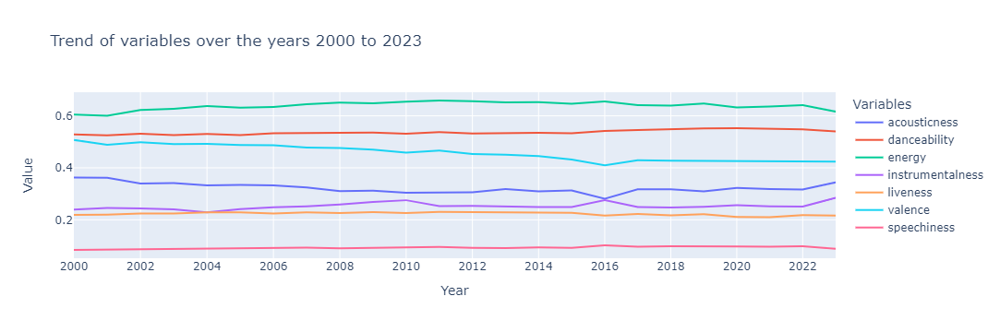

In [565]:
# Plot Trend of Variables over the years 2000 to 2023
px.line(df_melt, x='year' , y='value' , color='variable', labels={
                     "year": "Year",
                     "value": "Value",
                    "variable": "Variables"
    
                 }, log_x= True, title = 'Trend of variables over the years 2000 to 2023' )

After analyzing the trend of various song variables over the period of 2000 to 2023 using a line chart, we observed that there was minimal variation in Speechiness, Liveness, and Danceability. Furthermore, we noticed that there were only slight fluctuations in the variables of Energy, Valence, Acousticness, and Instrumentalness.

Additional conclusions that we can draw from these observations include that the overall trends for these variables have remained relatively stable over the analyzed time period. Moreover, while there may have been some subtle changes in these variables, they are not significant enough to suggest any major shifts in music preferences or production styles.

In [566]:
# Popularity trend analysis
pop_df = data_df.groupby(by=["year"]).popularity.mean().reset_index()

In [567]:
pop = pop_df.melt(id_vars='year', value_vars=['popularity'])

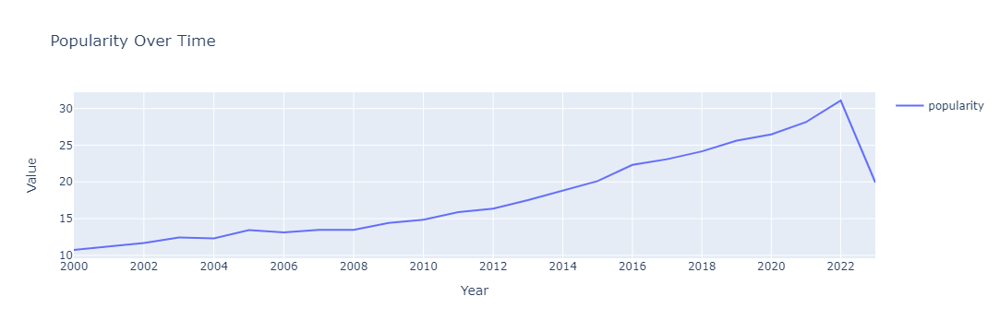

In [568]:
px.line(pop, x='year' , y='value' , color='variable', 
        labels={
                    "year": "Year",
                    "value": "Value",
                    "variable": ""    
                 }, 
        log_x= True,
        title = 'Popularity Over Time')

Based on the popularity distribution plot generated, we can infer that the average popularity has steadily increased over time, with a notable exception of a sharp decrease after the year 2022.This could possibly be due to the fact that we are still in Q1 of 2023 and number of songs released so far are limited.

#### Popularity Distribution Analysis

In [569]:
popularity_df = year_df[['year','popularity']]

# Convert the data type of year to Datetime
popularity_df['year'] = pd.to_datetime(popularity_df['year'], format = '%Y')

# Set the index as year
popularity_df.set_index('year',inplace = True)

popularity_df.head()

C:\Users\Ishrat Syed\AppData\Local\Temp\ipykernel_22532\1317478685.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,popularity
year,
2000-01-01,10.736181
2001-01-01,11.253359
2002-01-01,11.679041
2003-01-01,12.435730
2004-01-01,12.298732


In [570]:
data_df.describe().apply(lambda s: s.apply('{0:.5f}'.format)) 

,popularity,year,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,duration_mins
count,1159764.00000,1159764.00000,1159764.00000,1159764.00000,1159764.00000,1159764.00000,1159764.00000,1159764.00000,1159764.00000,1159764.00000,1159764.00000,1159764.00000,1159764.00000,1159764.00000,1159764.00000
mean,18.38312,2011.95500,0.53744,0.63967,5.28778,-8.98135,0.63465,0.09281,0.32154,0.25235,0.22302,0.45556,121.37714,3.88588,4.15936
std,15.88554,6.80390,0.18448,0.27050,3.55520,5.68221,0.48153,0.12684,0.35499,0.36507,0.20107,0.26852,29.77975,0.46770,2.49044
min,0.00000,2000.00000,0.00000,0.00000,0.00000,-58.10000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.03455
25%,5.00000,2006.00000,0.41300,0.45400,2.00000,-10.82900,0.00000,0.03710,0.00640,0.00000,0.09790,0.22600,98.79700,4.00000,3.01818
50%,15.00000,2012.00000,0.55000,0.69400,5.00000,-7.45000,1.00000,0.05070,0.14700,0.00176,0.13400,0.43800,121.93100,4.00000,3.76240
75%,29.00000,2018.00000,0.67700,0.87300,8.00000,-5.27600,1.00000,0.08900,0.64000,0.61400,0.29200,0.67400,139.90300,4.00000,4.78189
max,100.00000,2023.00000,0.99300,1.00000,11.00000,6.17200,1.00000,0.97100,0.99600,1.00000,1.00000,1.00000,249.99300,5.00000,100.00825


Text(0.5, 0, 'Popularity')

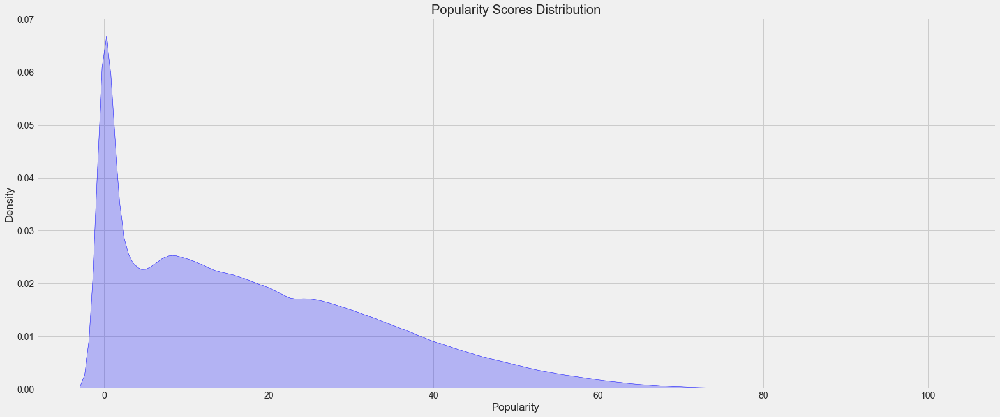

In [571]:
# plot polularity scores distribution
ax = sns.kdeplot(data_df['popularity'], shade=True, color='b') 
plt.title("Popularity Scores Distribution") 
plt.xlabel("Popularity")

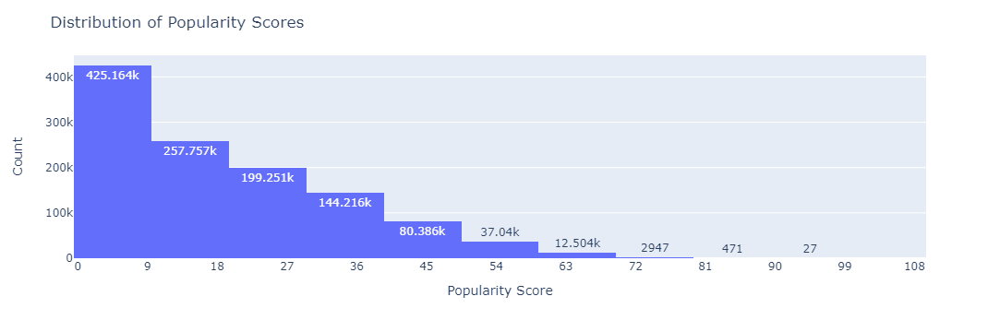

In [572]:
# Histogram for Distribution of Popularity Scores 
fig = px.histogram(data_df, x="popularity", nbins=20,text_auto=True)
fig.update_layout(
    title='Distribution of Popularity Scores',
    xaxis = dict(
        title='Popularity Score',
        tickmode = 'linear',
        tick0 = 9,
        dtick = 9
    ),
    yaxis=dict(title='Count')
    
)

fig.show()


By analyzing the distribution of Popularity in our dataset using a Histogram, we found that the data is significantly skewed towards records with a Popularity score ranging from 0 to 9. This indicates that a vast majority of the records in our dataset have low Popularity scores, while relatively few have higher scores.

#### Correlation Matrix

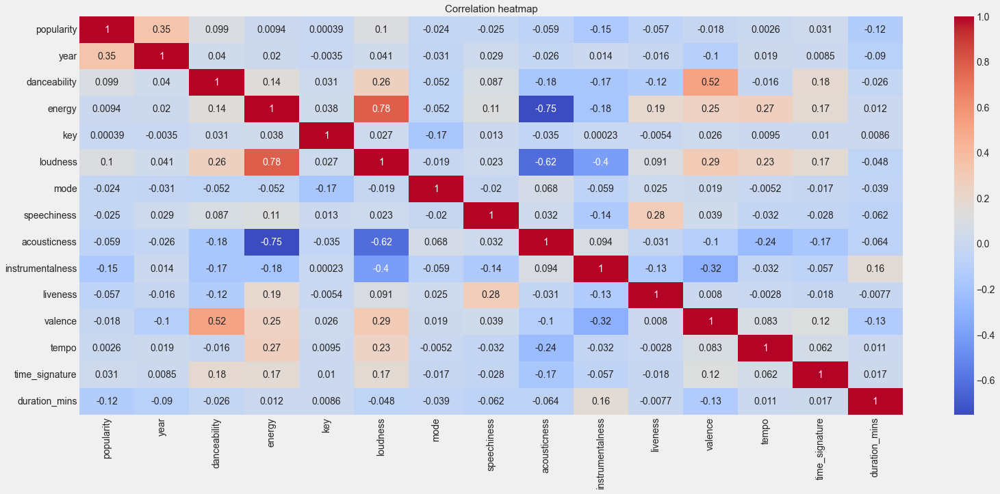

In [573]:
# plot a heatmap of the correlations of feature with every other feature
sns.heatmap(data_df.corr(), cmap="coolwarm",  annot=True, )
plt.title('Correlation heatmap', size=15);
plt.show()

We plotted a heatmap to analyse the correlation of each feature with every other feature in the dataset. Based on the correlation analysis, we can draw the following conclusions:

Energy and Loudness are highly correlated, indicating that they may have a strong influence on each other. Therefore, it may be beneficial to consider both of these features in a predictive model.

Valence and Danceability are moderately correlated, suggesting that they may also have a positive influence on each other. As a result, including both of these variables in a model may be beneficial.

Acousticness is negatively correlated with Energy and Loudness, indicating that songs with a more acoustic sound may have lower energy and volume. Therefore, it may be useful to include Acousticness as a feature in a predictive model.

Year has a weak to moderate positive correlation with Popularity, suggesting that songs released in more recent years may be more popular. However, other factors beyond the scope of this dataset may also influence a song's popularity.


#### Popularity Analysis By Genre

In [574]:
# Calculate the average popularity for each genre
avg_popularity_by_genre = data_df.groupby('genre')['popularity'].mean().reset_index()

In [575]:
# Sort genres by average popularity
sorted_genres = avg_popularity_by_genre.sort_values('popularity', ascending=False)

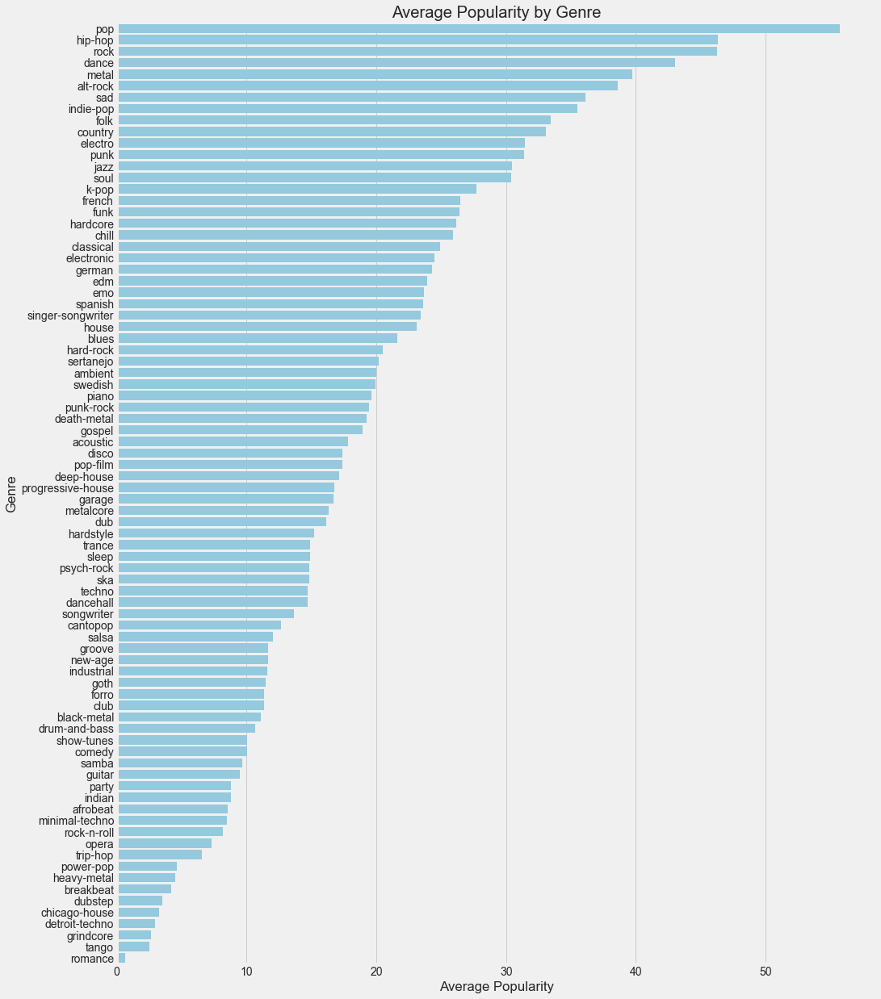

In [576]:
# Set the size of the plot
plt.figure(figsize=(15, 20))

# Create a bar chart of popularity by genre
sns.barplot(x='popularity', y='genre', data=sorted_genres, color='skyblue')
plt.xlabel('Average Popularity')
plt.ylabel('Genre')
plt.title('Average Popularity by Genre')
plt.show()

Our analysis of Average popularity by genre using a barchart showed that Pop, Hip Hop, and Rock are the top 3 most popular genres, with Pop having the highest average popularity. This information could be helpful in building a predictive model to predict song popularity, as it suggests that songs in these genres may be more likely to be popular with listeners. Additionally, it could be beneficial to include genre as a feature in the model, as we observed that popularity can vary significantly with each genre, indicating that the genre of a song may be an important factor in predicting its popularity.

In [577]:
# Visualizing the most popular songs from 2000 to 2023 by Genre
genre_df = data_df.groupby(['genre','year'])['popularity'].median().reset_index()


In [578]:
my_raceplot = barplot(genre_df,
                      item_column='genre',
                      value_column='popularity',
                      time_column='year'
             )


In [579]:
fig=my_raceplot.plot(
                 item_label = 'Genre',
                 value_label = 'Popularity',
                 frame_duration = 900)

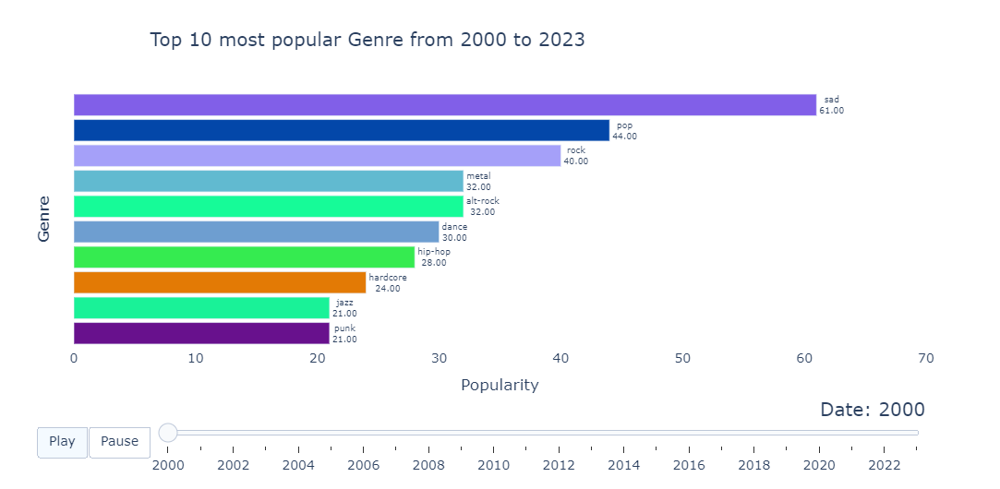

In [580]:
fig.update_layout(
      title='Top 10 most popular Genre from 2000 to 2023',
      title_x=0.15,
      width=1000,
      height=530,
      paper_bgcolor="white",
      )

After visualizing the popularity of different genres from 2000 to 2023, we found that Pop has been consistently the most popular genre, except for the year 2016. Rock, hip-hop, and dance genres have also maintained their popularity throughout the years. However, in recent years, genres like electro, sad, edm, house, k-pop, country, and indie-pop have also gained popularity. Therefore, if we go by the trends, it can be inferred that songs belonging to any of these popular genres have a higher chance of becoming popular. This insight can be useful for building a predictive model to predict the popularity of songs based on their genre.

#### Top 3 popluar artists for specific features

In [581]:
# Function to show top three artists from specific feature
def recommend_artists(feature):
    recomendation = artists_df[artists_df[feature] > artists_df[feature].quantile(0.9)].sort_values(by='popularity', ascending=False)
    return recomendation.head(3)

In [582]:
# Top 3 popluar artists:
artists_df.head(3)

,artist_name,popularity,year,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,duration_mins
40069,NewJeans,85.333333,2022.166667,0.744667,0.679833,6.500000,-4.568833,0.166667,0.092817,0.279767,5.116667e-07,0.127300,0.604667,133.764333,4.0,3.251008
17200,Elley Duhé,85.000000,2020.000000,0.410000,0.611000,4.000000,-8.271000,0.000000,0.046700,0.022800,0.000000e+00,0.116000,0.089900,185.727000,3.0,3.074133
45960,Rema,80.666667,2021.000000,0.845000,0.748000,8.333333,-5.570667,0.666667,0.047133,0.319000,1.913000e-03,0.114333,0.786667,108.007000,4.0,3.549478


In [583]:
# Top 3 Popluar artists with high danceability:
recommend_artists('danceability')

,artist_name,popularity,year,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,duration_mins
45960,Rema,80.666667,2021.0,0.845,0.748,8.333333,-5.570667,0.666667,0.047133,0.319,0.001913,0.114333,0.786667,108.007,4.0,3.549478
9719,Chani Nattan,80.000000,2021.0,0.847,0.558,8.000000,-5.855000,0.000000,0.066300,0.325,0.000000,0.135000,0.495000,98.062,4.0,2.184633
15238,Dj LK da Escócia,78.000000,2022.0,0.889,0.742,4.000000,-3.495000,0.000000,0.358000,0.299,0.000568,0.066000,0.479000,130.089,4.0,2.484617


In [584]:
# Top 3 Popluar artists with high energy:
recommend_artists('energy')

,artist_name,popularity,year,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,duration_mins
63603,yama,71.000000,2022.000000,0.581000,0.926000,7.000000,-3.2680,0.000000,0.066200,0.176000,0.000000,0.251000,0.874,117.040000,4.0,3.202933
34967,Majestic,69.500000,2021.500000,0.691000,0.926500,8.500000,-3.2985,0.000000,0.138000,0.002312,0.002080,0.253000,0.770,128.027000,4.0,2.775492
1267,Ado,64.666667,2021.333333,0.561333,0.966333,7.666667,-2.4330,0.333333,0.133267,0.042283,0.000001,0.196333,0.401,161.035667,4.0,3.483111


In [585]:
# Top 3 Popluar artists with high valence:
recomend_artists('valence')

,artist_name,popularity,year,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,duration_mins
45960,Rema,80.666667,2021.0,0.845,0.748,8.333333,-5.570667,0.666667,0.047133,0.319,0.001913,0.114333,0.786667,108.007,4.0,3.549478
42143,Oxlade,79.000000,2022.0,0.649,0.655,10.000000,-5.534000,0.000000,0.065200,0.307,0.000000,0.220000,0.793000,92.900,4.0,2.459683
50953,Soegi Bornean,78.000000,2019.0,0.721,0.565,4.000000,-6.208000,1.000000,0.029200,0.855,0.000005,0.097300,0.794000,139.941,4.0,4.247700


In [586]:
# Top 3 Popluar artists with high instrumentalness:
recomend_artists('instrumentalness')

,artist_name,popularity,year,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,duration_mins
20584,Gaea Antoniou,68.0,2021.0,0.0802,0.00761,2.0,-32.863,1.0,0.0497,0.975000,0.9000,0.1120,0.0623,172.6760,4.0,2.950000
48983,Sean Altar,67.0,2022.0,0.1800,0.01870,0.0,-31.807,1.0,0.0440,0.969000,0.9160,0.1280,0.0339,71.1350,3.0,2.314283
63179,jagger finn,65.5,2019.0,0.5250,0.53700,0.0,-9.635,1.0,0.0276,0.463315,0.8495,0.1875,0.3915,92.0495,4.0,2.222758


#### Analysis Of Most Popular Artists with Most number of Songs

In [ ]:
# Calculate the Total number of songs per artist
total_songs_per_artist = data_df.groupby('artist_name')['track_name'].count().reset_index()

In [ ]:
sorted_artist = total_songs_per_artist.sort_values('track_name', ascending=False)

In [ ]:
top_10_song_creator=sorted_artist.head(10)

In [ ]:
top_10_song_creator

,artist_name,track_name
58377,Traditional,4058
21879,Grateful Dead,2320
27409,Johann Sebastian Bach,2125
21208,Giacomo Meyerbeer,1345
17270,Elvis Presley,1242
61489,Wolfgang Amadeus Mozart,1084
3992,Armin van Buuren,1061
4323,Astor Piazzolla,932
22801,Hans Zimmer,863
2998,Andrei Krylov,841


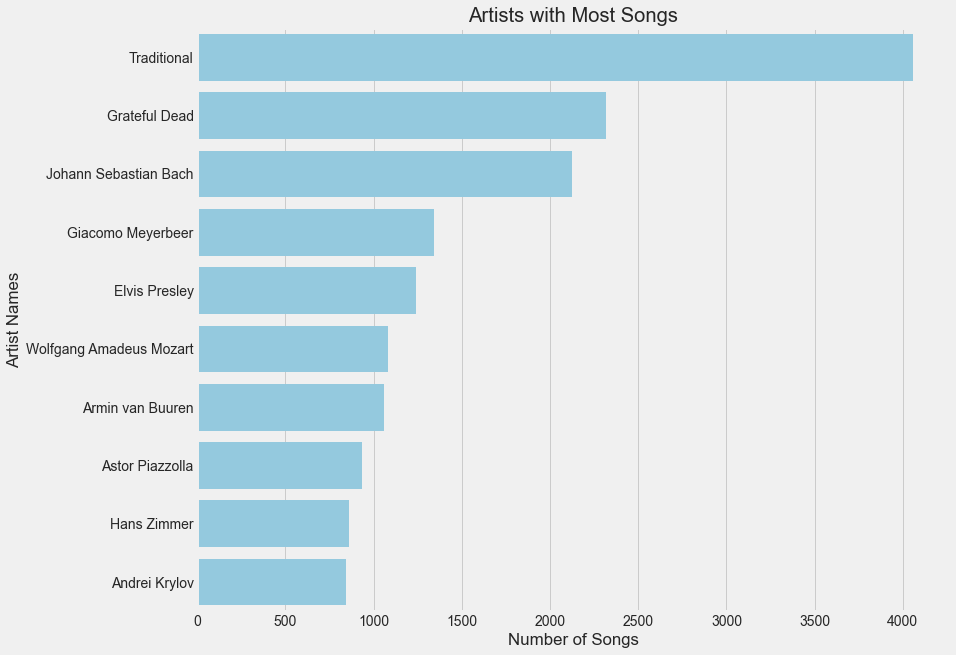

In [ ]:
# Set the size of the plot
plt.figure(figsize=(12, 10))

# Create a bar chart of Artist with most number of songs
sns.barplot(y='artist_name', x='track_name', data=top_10_song_creator, color='skyblue')
plt.xlabel('Number of Songs')
plt.ylabel('Artist Names')
plt.title('Artists with Most Songs')
plt.show()

In [ ]:
top_10_song_creator.artist_name.to_list()

['Traditional',
 'Grateful Dead',
 'Johann Sebastian Bach',
 'Giacomo Meyerbeer',
 'Elvis Presley',
 'Wolfgang Amadeus Mozart',
 'Armin van Buuren',
 'Astor Piazzolla',
 'Hans Zimmer',
 'Andrei Krylov']

In [ ]:
art_box= data_df[data_df.artist_name.isin(['Traditional',
 'Grateful Dead',
 'Johann Sebastian Bach',
 'Giacomo Meyerbeer',
 'Elvis Presley',
 'Wolfgang Amadeus Mozart',
 'Armin van Buuren',
 'Astor Piazzolla',
 'Hans Zimmer',
 'Andrei Krylov'])]

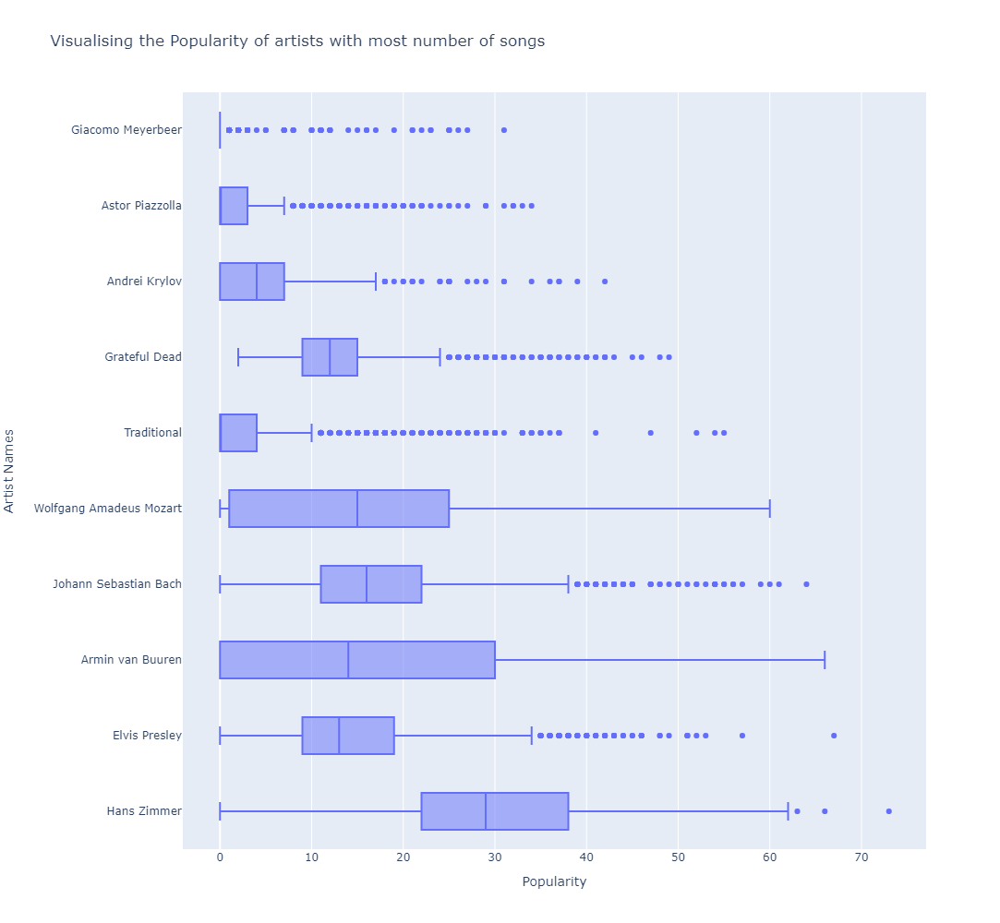

In [594]:
#Plot the Popularity of artist with the most number of songs
fig = px.box(art_box, y="artist_name", x="popularity", width=1000,
    height=1000,title='Visualising the Popularity of artists with most number of songs',
        labels={
                    "artist_name": "Artist Names",
                    "popularity": "Popularity", 
                 }  )
fig.show()

The box plot indicates that there is a weak correlation between the number of songs released by an artist and their level of popularity. This means that having the highest number of songs does not necessarily translate to being a popular artist.